### Assignment 4 Option 2

# The Relationship Between Tectonic Activity and Mining Activity

##### Name: Terry Rozmus (not in a group)

##### Student ID: 94131529

##### Python Version number: 2.7.14

### Part 2 of 5

## Contents

<table>
<tbody>
    <tr>
        <td>
            &nbsp; &nbsp;
        </td>
        <td style="text-align: left;">
            <a href="#Initialisation">Initialisation</a>
        </td>
    </tr>
    <tr>
        <td></td>
        <td style="text-align: left;">
            &nbsp; &nbsp; 
            <a href="#Initialisation1">Import Modules</a>
        </td>
    </tr>
    <tr>
        <td></td>
        <td style="text-align: left;">
            &nbsp; &nbsp; 
            <a href="#Initialisation2">Settings</a>
        </td>
    </tr>
    <tr>
        <td></td>
        <td style="text-align: left;">
            &nbsp; &nbsp; 
            <a href="#Initialisation3">Define Some Functions</a>
        </td>
    </tr>
    <tr>
        <td>
        </td>
        <td style="text-align: left;">
            &nbsp; &nbsp;
            <a href="#ReloadData">Reload Data</a>
        </td>
    </tr>
    <tr>
        <td>
            &nbsp; &nbsp;
        </td>
        <td style="text-align: left;">
            <a href="#EDA">Exploratory Analysis of Aggregated Data</a>
        </td>
    </tr>
    <tr>
        <td></td>
        <td style="text-align: left;">
            &nbsp; &nbsp; 
            <a href="#TransformSamples">Transform Samples</a>
        </td>
    </tr>
    <tr>
        <td></td>
        <td style="text-align: left;">
            &nbsp; &nbsp; 
            <a href="#TransformedSamplesConclusion">Conclusions About Transformed Samples</a>
        </td>
    </tr>
</tbody>
</table>
<br>

<a name="Initialisation"></a>
## Initialisation

<a name="Initialisation1"></a>
### Import Modules

In [1]:
import requests
import json
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from pylab import rcParams
import math
from shapely.geometry import Point
import warnings
import random
import re

%matplotlib inline

<a name="Initialisation2"></a>
### Settings and Values

In [2]:
# pd.set_option('html', True)
pd.set_option('max_columns', 30)
pd.set_option('max_rows', 400)
rcParams['figure.figsize'] = 20, 16
rcParams['font.size'] = 20
rcParams['figure.dpi'] = 350
rcParams['lines.linewidth'] = 2
rcParams['axes.facecolor'] = 'white'
rcParams['patch.edgecolor'] = 'white'
rc={'axes.labelsize': 10, 'font.size': 10, 'legend.fontsize': 10, 'axes.titlesize': 10}
plt.rcParams.update(**rc)
sns.set_style("white")
sns.set_style("ticks")
sns.set_context({"figure.figsize": (12, 9)})
warnings.filterwarnings('ignore')

<a name="Initialisation3"></a>
### Define Some Functions

In [3]:
def plotSampleLocations(samples, radius):
    base = world.plot(color='white', edgecolor='#ededed', figsize=(18, 15))
    base.set_axis_bgcolor('#d5d5e8')

    mountains.to_crs({'init': 'epsg:4326'}).plot(ax=base, color='black', alpha=0.2, markersize=0.1)
    # Calculate 500 km radius bounding circles
    sampleCircles = gpd.GeoDataFrame(samples['id'], geometry = samples.buffer(radius))
    sampleCircles.to_crs({'init': 'epsg:4326'}).plot(ax=base, color='red', edgecolor='black', alpha=0.1, markersize=0.1)
    samples.to_crs({'init': 'epsg:4326'}).plot(ax=base, color='black', alpha=0.7, markersize=0.1)

In [4]:
# Define function for plotting histograms for all variables in a passed in list.
def histos(df, variables, title):
    r = int(math.ceil(float(len(variables) / 3.0)))
    fig, ax = plt.subplots(ncols = 3, nrows = r, figsize = (20, r * 4))
    fig.suptitle(title, fontsize=16)
    fig.subplots_adjust(top=0.95)
    i = 0
    for variable in variables:
        x = i // 3
        y = i % 3
        df.loc[((df[variable] != float('-inf')) & (df[variable] != float('inf'))), variable].hist(bins=70, facecolor='blue', alpha = 0.6, ax = ax[x, y])
        ax[x, y].set_xlabel(variable, fontsize=10)
        ax[x, y].set_ylabel('Frequency', fontsize=10)
        i = i + 1

In [5]:
# Make a dataset containing log transforms of the response variables of a dataset
# return a dataset containing both the original variables and transformed variables
def calculateTransform(df, variables, idColumn, transform):
    T = transform
    vv = variables
    idL = idColumn
    idR = idColumn + 'R'
    # Renames
    r = {i: T + i for i in vv}
    r[idL] = idR
    
    df2 = df[[idL] + vv].copy()
    if (T == 'Log'):
        df2[vv] = df2[vv].apply(np.log, axis = 0)
    elif (T == 'Log10'):
        df2[vv] = df2[vv].apply(np.log10, axis = 0)
    elif (T == 'SqRt'):
        df2[vv] = df2[vv].apply(np.sqrt, axis = 0)
    elif (T == 'CubeRt'):
        df2[vv] = df2[vv].apply(np.cbrt, axis = 0)
    elif (T == 'Reciprocal'):
        df2[vv] = df2[vv].apply(lambda x: 1 / x, axis = 0)
    elif (T == 'ReciprocalSq'):
        df2[vv] = df2[vv].apply(lambda x: 1 / (x ** 2.0), axis = 0)
    df2 = df2.rename(columns = r)
    df = pd.merge(df, df2, left_on = idL, right_on = idR, how = 'left', copy = False).drop(idR, axis=1)
    
    # Make sure infinite values do not generate errors when plotting
    df = df.replace([np.inf, -np.inf], np.nan)

    return df

<a name="ReloadData"></a>
### Reload Data

In [6]:
# Reload 
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world[(world.name!="Antarctica")]
mountains = gpd.read_file("Datasets/GMBA Mountain Directory/GMBA mountain inventory_V1.1-World.shp")

In [7]:
# Reload the earthquake dataset if required
samples = gpd.read_file('Datasets/Samples/Samples.shp')
samples.crs = {'init': 'epsg:4087'}

# Shape files seem to have a character limit on column names, so rename the truncated ones
samples = samples.rename(columns={'Earthquake': 'Earthquakes', 'LandPercen': 'LandPercentage', 'MountainPe': 'MountainPercentage'})
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841)


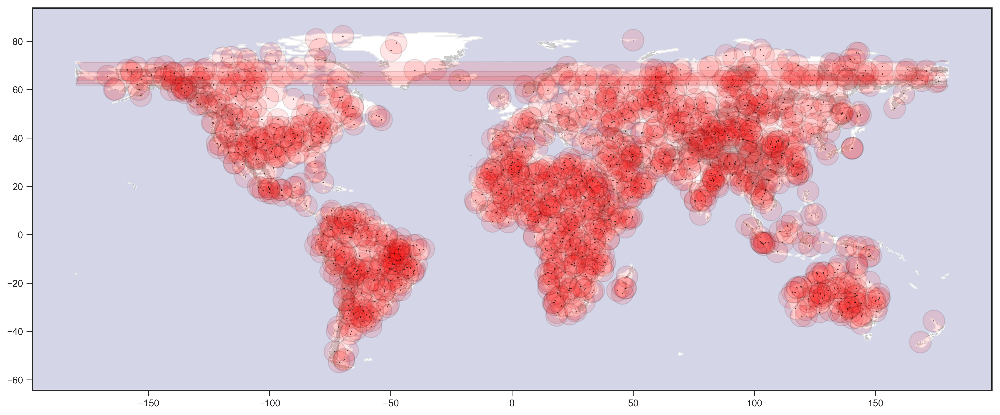

In [8]:
plotSampleLocations(samples, 500000)

<a name="EDA"></a>
## Exploratory Analysis of Aggregated Data

<a name="TransformSamples"></a>
### Transform Samples

In [9]:
variables = [
    u'Mines',
    u'Volcanoes',
    u'Earthquakes',
    u'Petroleum',
    u'LandPercentage',
    u'MountainPercentage',
]

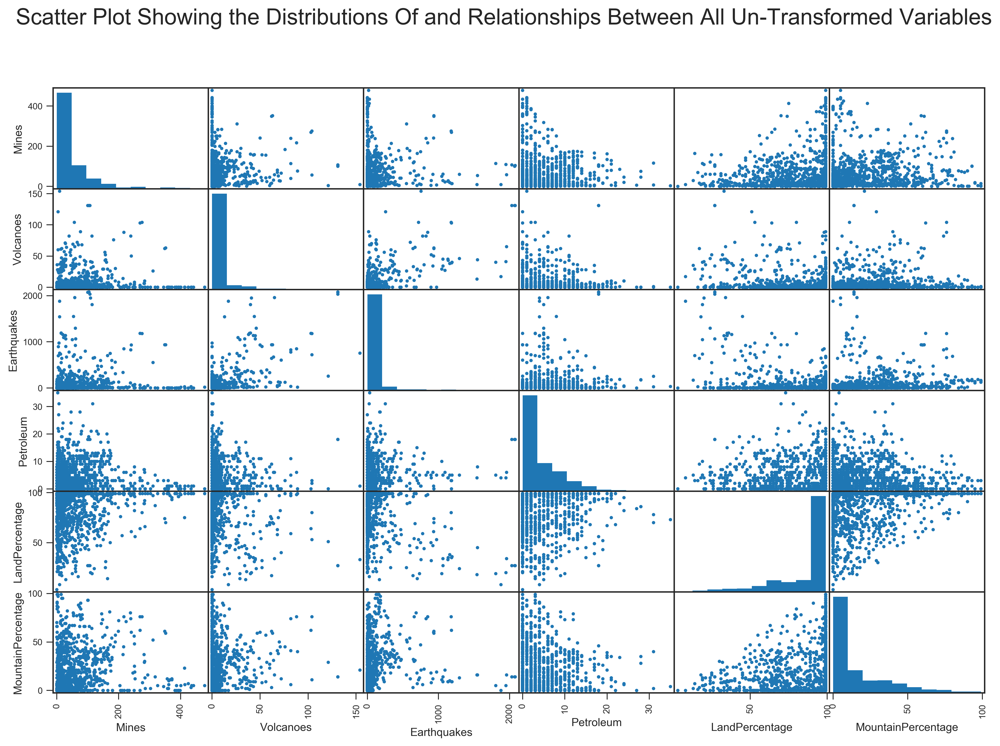

In [10]:
pd.tools.plotting.scatter_matrix(samples[variables], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Un-Transformed Variables', fontsize=20)
plt.show()

Clearly all the variables I intend to test are right-skewed according to the histograms and heterochedastic because the scatterplots fan out. They may benefit from being transformed in some way to make the data more normally-distributed and homoschedastic.

Calculate logs for the variables and store in the samples dataframe.

In [11]:
samples = calculateTransform(samples, variables, 'id', 'Log')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148


Add untransformed Mines (metals) and Petroleum to the scatter plots ahead because these are ultimately the features that need to be predicted and in the case of regression response variables should not be transformed.

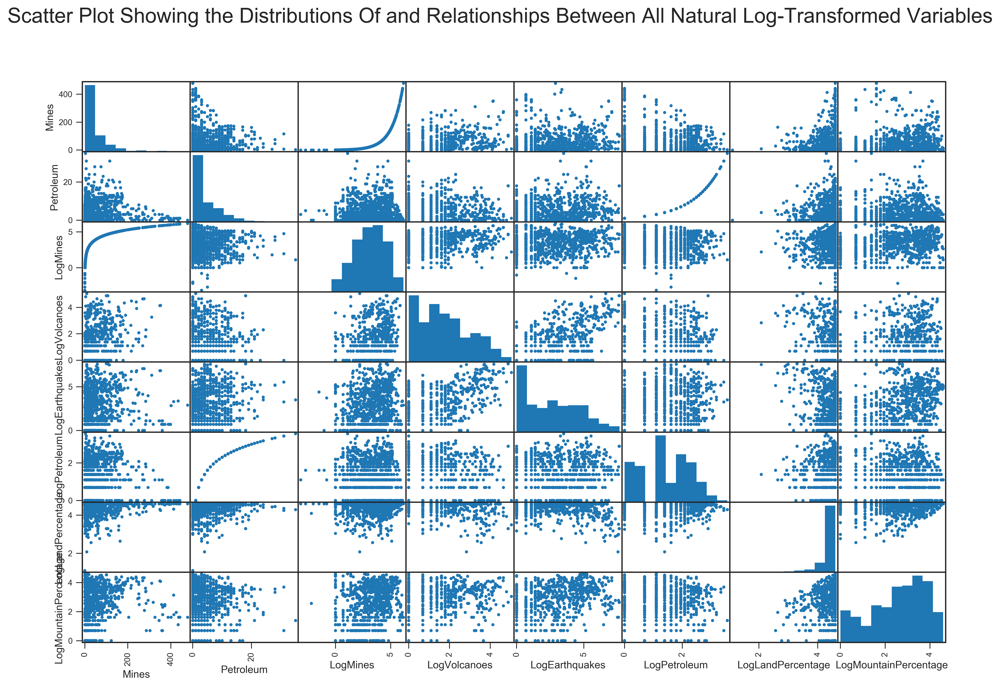

In [12]:
logVars = ['Mines', 'Petroleum'] + ['Log' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[logVars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Natural Log-Transformed Variables', fontsize=20)
plt.show()

In [13]:
samples = calculateTransform(samples, variables, 'id', 'Log10')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage,Log10Mines,Log10Volcanoes,Log10Earthquakes,Log10Petroleum,Log10LandPercentage,Log10MountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148,0.60206,0.69897,1.724276,0.90309,1.995635,1.672098


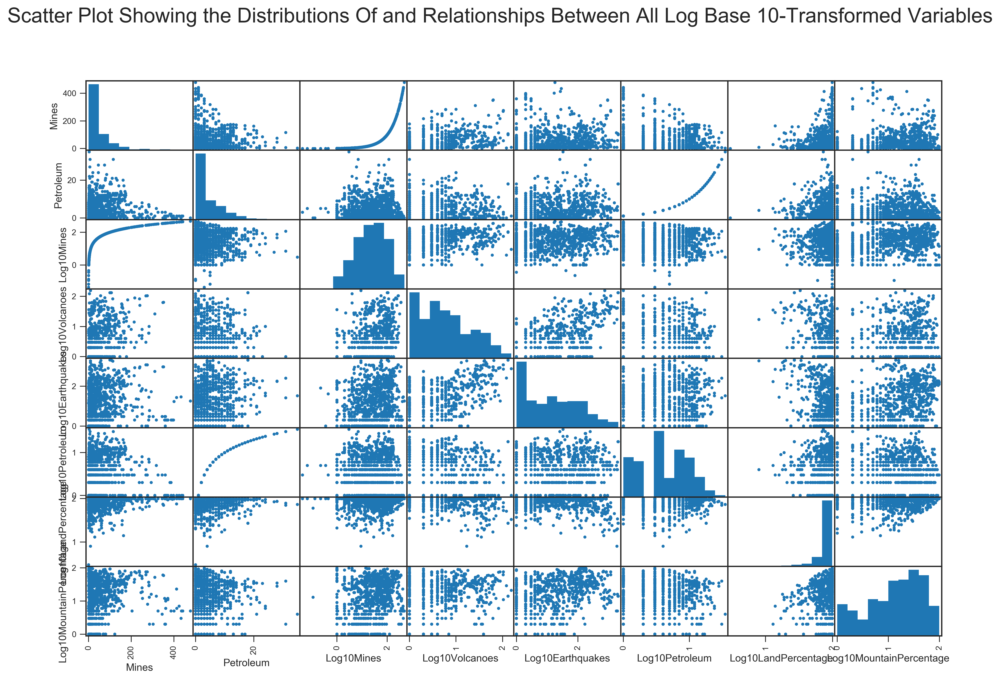

In [14]:
log10Vars = ['Mines', 'Petroleum'] + ['Log10' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[log10Vars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Log Base 10-Transformed Variables', fontsize=20)
plt.show()

The distribution of log-10 transformed data is remarkably similar to natural log transformed data. The only difference is the range of the predictor scale.

In [15]:
samples = calculateTransform(samples, variables, 'id', 'SqRt')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage,Log10Mines,Log10Volcanoes,Log10Earthquakes,Log10Petroleum,Log10LandPercentage,Log10MountainPercentage,SqRtMines,SqRtVolcanoes,SqRtEarthquakes,SqRtPetroleum,SqRtLandPercentage,SqRtMountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148,0.60206,0.69897,1.724276,0.90309,1.995635,1.672098,2.0,2.236068,7.28011,2.828427,9.949874,6.855655


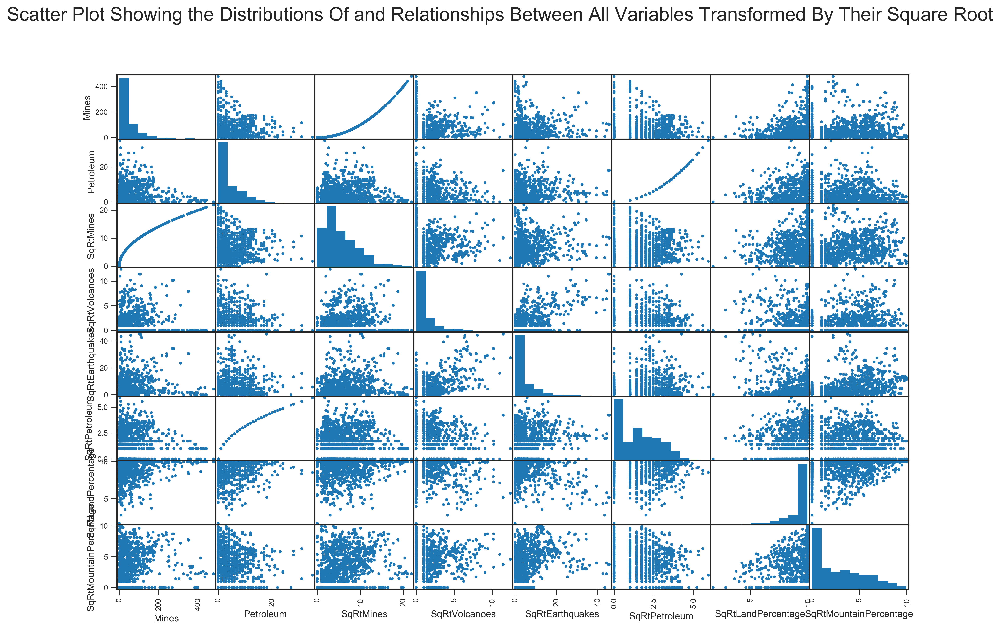

In [16]:
sqRtVars = ['Mines', 'Petroleum'] + ['SqRt' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[sqRtVars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Variables Transformed By Their Square Root', fontsize=20)
plt.show()

In [17]:
samples = calculateTransform(samples, variables, 'id', 'CubeRt')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage,Log10Mines,...,Log10Petroleum,Log10LandPercentage,Log10MountainPercentage,SqRtMines,SqRtVolcanoes,SqRtEarthquakes,SqRtPetroleum,SqRtLandPercentage,SqRtMountainPercentage,CubeRtMines,CubeRtVolcanoes,CubeRtEarthquakes,CubeRtPetroleum,CubeRtLandPercentage,CubeRtMountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148,0.60206,...,0.90309,1.995635,1.672098,2.0,2.236068,7.28011,2.828427,9.949874,6.855655,1.587401,1.709976,3.756286,2.0,4.626065,3.608826


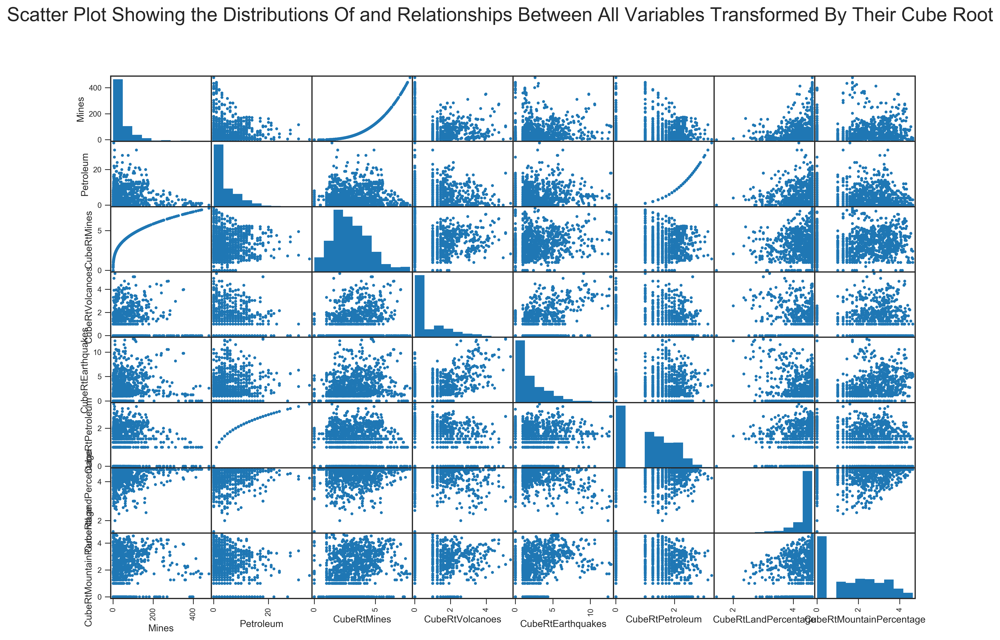

In [18]:
cubeRtVars = ['Mines', 'Petroleum'] + ['CubeRt' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[cubeRtVars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Variables Transformed By Their Cube Root', fontsize=20)
plt.show()

In [19]:
samples = calculateTransform(samples, variables, 'id', 'Reciprocal')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage,Log10Mines,...,SqRtPetroleum,SqRtLandPercentage,SqRtMountainPercentage,CubeRtMines,CubeRtVolcanoes,CubeRtEarthquakes,CubeRtPetroleum,CubeRtLandPercentage,CubeRtMountainPercentage,ReciprocalMines,ReciprocalVolcanoes,ReciprocalEarthquakes,ReciprocalPetroleum,ReciprocalLandPercentage,ReciprocalMountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148,0.60206,...,2.828427,9.949874,6.855655,1.587401,1.709976,3.756286,2.0,4.626065,3.608826,0.25,0.2,0.018868,0.125,0.010101,0.021277


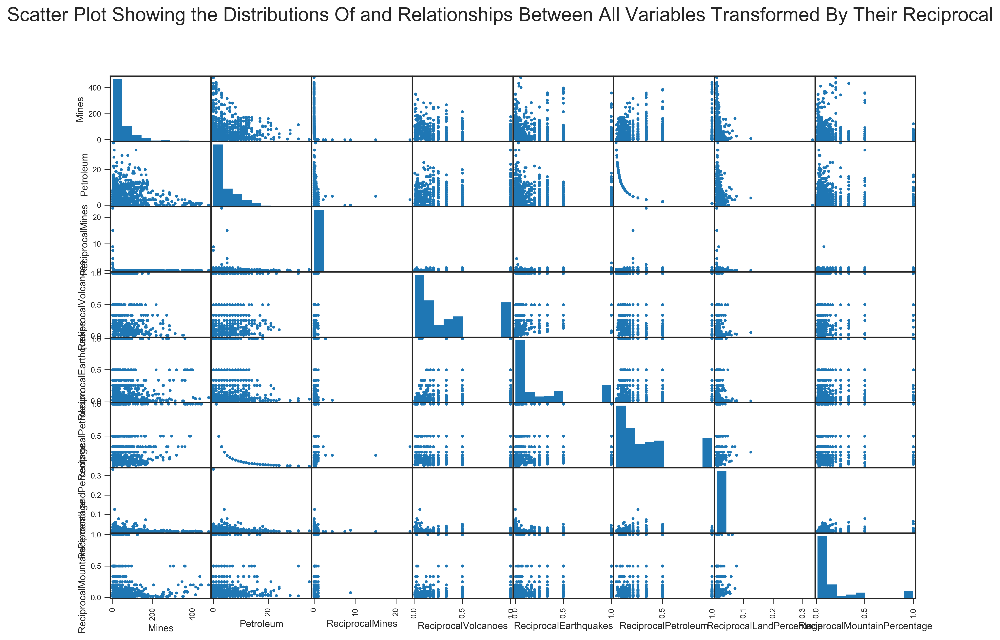

In [20]:
recipVars = ['Mines', 'Petroleum'] + ['Reciprocal' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[recipVars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Variables Transformed By Their Reciprocal', fontsize=20)
plt.show()

In [21]:
samples = calculateTransform(samples, variables, 'id', 'ReciprocalSq')
samples.head(1)

,id,Mines,Volcanoes,Petroleum,LandPercentage,MountainPercentage,Earthquakes,geometry,LogMines,LogVolcanoes,LogEarthquakes,LogPetroleum,LogLandPercentage,LogMountainPercentage,Log10Mines,...,CubeRtPetroleum,CubeRtLandPercentage,CubeRtMountainPercentage,ReciprocalMines,ReciprocalVolcanoes,ReciprocalEarthquakes,ReciprocalPetroleum,ReciprocalLandPercentage,ReciprocalMountainPercentage,ReciprocalSqMines,ReciprocalSqVolcanoes,ReciprocalSqEarthquakes,ReciprocalSqPetroleum,ReciprocalSqLandPercentage,ReciprocalSqMountainPercentage
0,0,4.0,5.0,8.0,99.0,47.0,53.0,POINT (7211026.799242427 3650604.689283841),1.386294,1.609438,3.970292,2.079442,4.59512,3.850148,0.60206,...,2.0,4.626065,3.608826,0.25,0.2,0.018868,0.125,0.010101,0.021277,0.0625,0.04,0.000356,0.015625,0.000102,0.000453


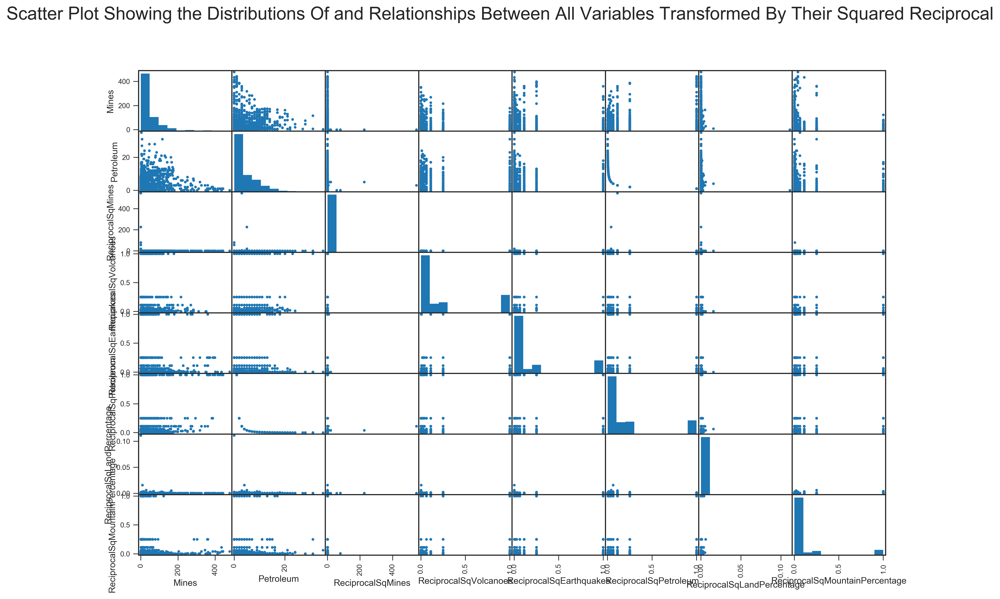

In [22]:
recipSqVars = ['Mines', 'Petroleum'] + ['ReciprocalSq' + v for v in variables]
pd.tools.plotting.scatter_matrix(samples[recipSqVars], alpha=1, figsize=(15, 10), diagonal='hist')
plt.suptitle('Scatter Plot Showing the Distributions Of and Relationships Between All Variables Transformed By Their Squared Reciprocal', fontsize=20)
plt.show()

<a name="TransformedSamplesConclusion"></a>
### Conclusions About Transformed Samples

None of the transformations was particularly successful across the whole dataset at shifting the data points do they are more normally-distributed. Log transformations did appear to make the distributions less fanned-out, however, suggesting they became more homoscedastic.

At this point I realised though that I may be trying to force together data from very different situtions across the planet. For example, there are large areas with no mountains or volcanoes, so comparing these regions with other regions that do have these features is likely to give confusing results. An analogy is if I am trying to take the mean height of a group of people from data someone gave me, but I didn't know that the people were a circus troupe with one-third groupings of dwarves, giants and average-height people, I might be a confused by the results. The distribution from this analysis would most-likely be tri-modal, but without having seen the people I might think the results were strange.

Looking at my own analysis geologically, metals are implaced in igneous rocks, but they can be found in at least four very different kinds of geological setting. Firstly, they can be found in active tectonic zones where there will be mountains, volcanoes and earthquakes. Secondly they can be found in mountainous areas where there are no active volcanoes or earthquakes because tectonism has long since ceased. Thirdly they can be found in very ancient heavily-eroded geological deposits called cratons where there are no earthquakes, volcanoes or mountains. Lastly, metals can also be implaced in sedimentary deposits a great distance from their igneous source material.

Each of these geolgical situations is very different and will look very different if data from all of them is examined together. It is for this reason that I decided it would be good to take a look at filtering my data into sets with particular properties, such as containing at least some mountains, so I can more-tightly focus my analysis on specific kinds of landscapes. 